In [1]:
import pandas as pd
import numpy as np

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import plotly.express as px

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
df = pd.read_csv('air-quality-india.csv')

In [6]:
df.head()

,Timestamp,Year,Month,Day,Hour,PM2.5
0,07-11-2017 12:00,2017,11,7,12,64.51
1,07-11-2017 13:00,2017,11,7,13,69.95
2,07-11-2017 14:00,2017,11,7,14,92.79
3,07-11-2017 15:00,2017,11,7,15,109.66
4,07-11-2017 16:00,2017,11,7,16,116.50


In [7]:
df.tail()

,Timestamp,Year,Month,Day,Hour,PM2.5
36187,04-06-2022 11:00,2022,6,4,11,35.89
36188,04-06-2022 12:00,2022,6,4,12,33.83
36189,04-06-2022 13:00,2022,6,4,13,33.05
36190,04-06-2022 14:00,2022,6,4,14,35.29
36191,04-06-2022 15:00,2022,6,4,15,40.67


In [8]:
df.shape

(36192, 6)

In [9]:
df.columns

Index(['Timestamp', 'Year', 'Month', 'Day', 'Hour', 'PM2.5'], dtype='object')

In [10]:
df.duplicated().sum()

0

In [11]:
df.isnull().sum()

Timestamp    0
Year         0
Month        0
Day          0
Hour         0
PM2.5        0
dtype: int64

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36192 entries, 0 to 36191
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Timestamp  36192 non-null  object 
 1   Year       36192 non-null  int64  
 2   Month      36192 non-null  int64  
 3   Day        36192 non-null  int64  
 4   Hour       36192 non-null  int64  
 5   PM2.5      36192 non-null  float64
dtypes: float64(1), int64(4), object(1)
memory usage: 1.7+ MB


In [13]:
df.describe()

,Year,Month,Day,Hour,PM2.5
count,36192.000000,36192.000000,36192.000000,36192.000000,36192.000000
mean,2019.682278,6.331841,15.716401,11.477840,49.308429
std,1.345011,3.593321,8.859769,6.925088,24.863511
min,2017.000000,1.000000,1.000000,0.000000,7.020000
25%,2019.000000,3.000000,8.000000,5.000000,28.080000
50%,2020.000000,6.000000,16.000000,11.000000,45.730000
75%,2021.000000,10.000000,23.000000,17.000000,64.520000
max,2022.000000,12.000000,31.000000,23.000000,245.630000


In [14]:
df.nunique()

Timestamp    36192
Year             6
Month           12
Day             31
Hour            24
PM2.5         9202
dtype: int64

In [15]:
df['Year'].unique()

array([2017, 2018, 2019, 2020, 2021, 2022], dtype=int64)

In [16]:
df['Year'].value_counts()

2020    8356
2021    8283
2019    7685
2018    7537
2022    3194
2017    1137
Name: Year, dtype: int64

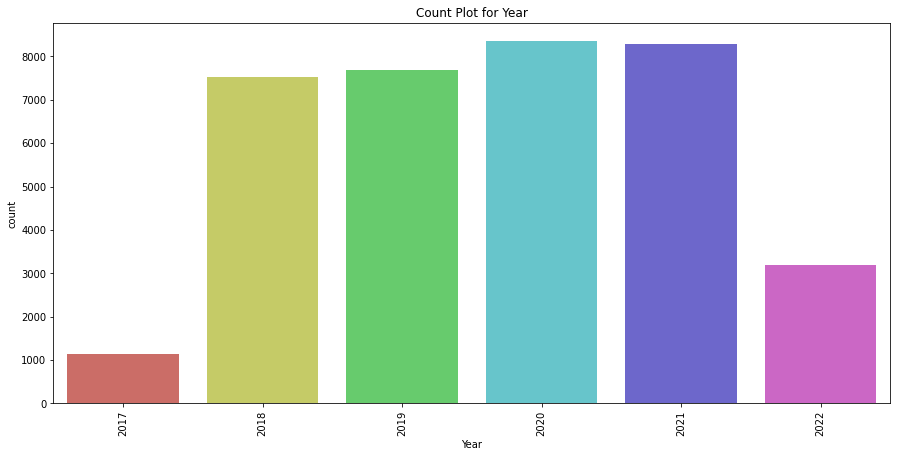

In [17]:
plt.figure(figsize=[15,7],)
plt.title('Count Plot for Year')
sns.countplot(x = 'Year', data = df, palette = 'hls')
plt.xticks(rotation = 90)
plt.show()

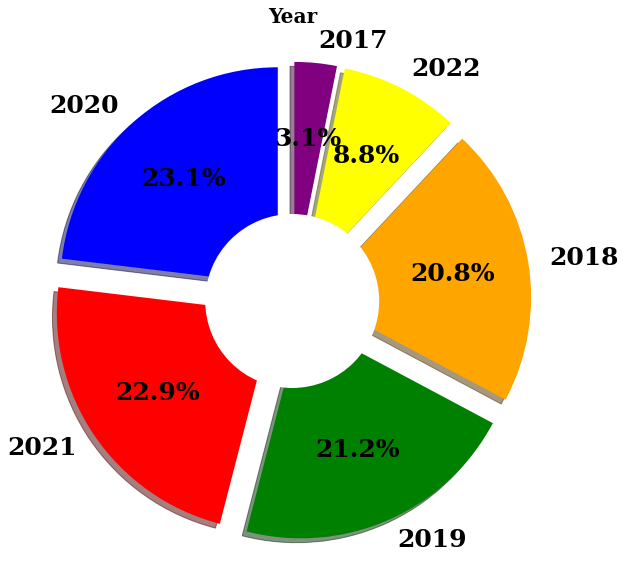

In [18]:
year_data = df['Year'].value_counts()

explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
plt.figure(figsize=(14, 10))
patches, texts, pcts = plt.pie(year_data,
                               labels = year_data.index,
                               colors = ['blue', 'red', 'green', 'orange',
                                        'yellow', 'purple'],
                               pctdistance = 0.65,
                               shadow = True,
                               startangle = 90,
                               explode = explode,
                               autopct = '%1.1f%%',
                               textprops={ 'fontsize': 25,
                                           'color': 'black',
                                           'weight': 'bold',
                                           'family': 'serif' })
plt.setp(pcts, color='black')

hfont = {'fontname':'serif', 'weight': 'bold'}
plt.title('Year', size=20, **hfont)

centre_circle = plt.Circle((0,0),0.40,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.show()

In [19]:
df_new = df.copy()

In [20]:
df_new['Timestamp']=pd.to_datetime(df_new['Timestamp'])

In [21]:
df_new = df_new.set_index('Timestamp')

In [22]:
df_new.head()

,Year,Month,Day,Hour,PM2.5
Timestamp,,,,,
2017-07-11 12:00:00,2017,11,7,12,64.51
2017-07-11 13:00:00,2017,11,7,13,69.95
2017-07-11 14:00:00,2017,11,7,14,92.79
2017-07-11 15:00:00,2017,11,7,15,109.66
2017-07-11 16:00:00,2017,11,7,16,116.50


In [23]:
df_new.tail()

,Year,Month,Day,Hour,PM2.5
Timestamp,,,,,
2022-04-06 11:00:00,2022,6,4,11,35.89
2022-04-06 12:00:00,2022,6,4,12,33.83
2022-04-06 13:00:00,2022,6,4,13,33.05
2022-04-06 14:00:00,2022,6,4,14,35.29
2022-04-06 15:00:00,2022,6,4,15,40.67


In [24]:
df1 = df_new[df_new['Year'] == 2017]
df2 = df_new[df_new['Year'] == 2018]
df3 = df_new[df_new['Year'] == 2019]
df4 = df_new[df_new['Year'] == 2020]
df5 = df_new[df_new['Year'] == 2021]
df6 = df_new[df_new['Year'] == 2022]

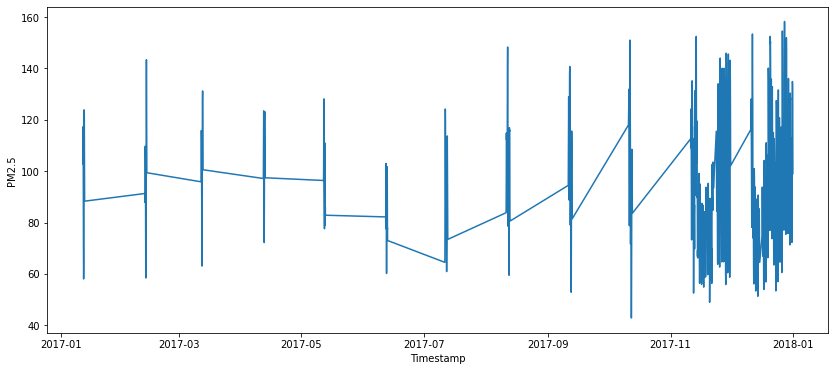

In [25]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df1.index, y="PM2.5", data=df1)
plt.show()

In [26]:
fig = px.line(df1, x=df1.index, y="PM2.5", title='Time Series Analysis - 2017')
fig.show()

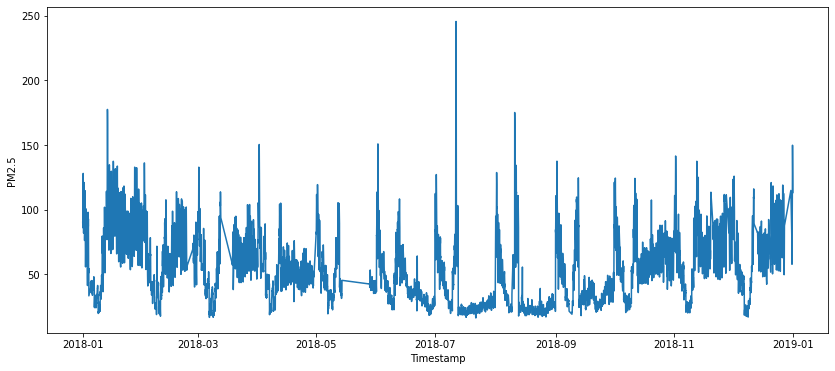

In [27]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df2.index, y="PM2.5", data=df2)
plt.show()

In [28]:
fig = px.line(df2, x=df2.index, y="PM2.5", title='Time Series Analysis - 2018')
fig.show()

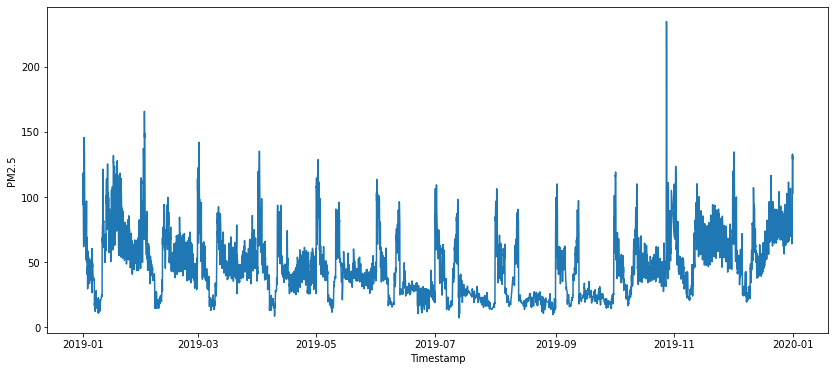

In [29]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df3.index, y="PM2.5", data=df3)
plt.show()

In [30]:
fig = px.line(df3, x=df3.index, y="PM2.5", title='Time Series Analysis - 2019')
fig.show()

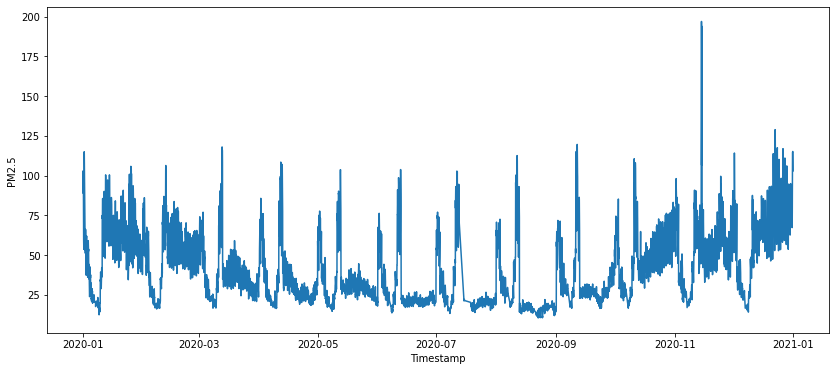

In [31]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df4.index, y="PM2.5", data=df4)
plt.show()

In [32]:
fig = px.line(df4, x=df4.index, y="PM2.5", title='Time Series Analysis - 2020')
fig.show()

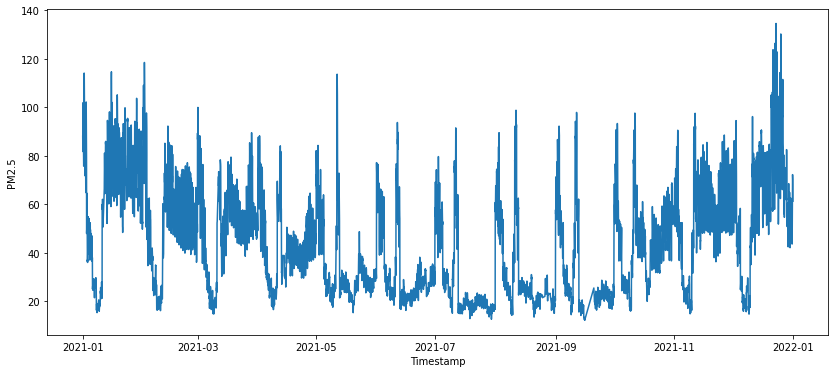

In [33]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df5.index, y="PM2.5", data=df5)
plt.show()

In [34]:
fig = px.line(df5, x=df5.index, y="PM2.5", title='Time Series Analysis - 2021')
fig.show()

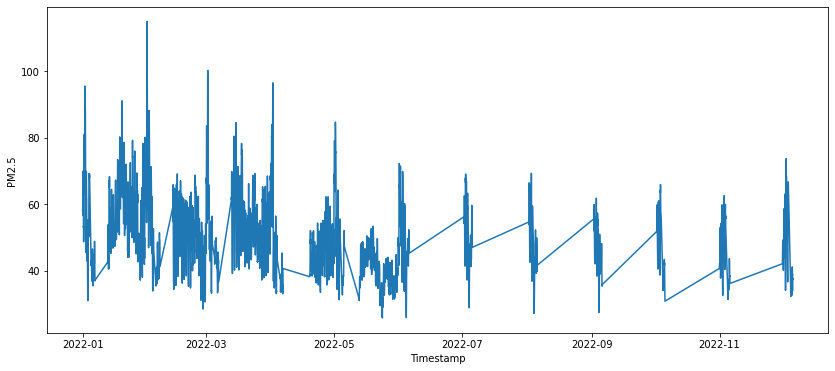

In [35]:
plt.figure(figsize = (14,6))
sns.lineplot(x=df6.index, y="PM2.5", data=df6)
plt.show()

In [36]:
fig = px.line(df6, x=df6.index, y="PM2.5", title='Time Series Analysis - 2022')
fig.show()

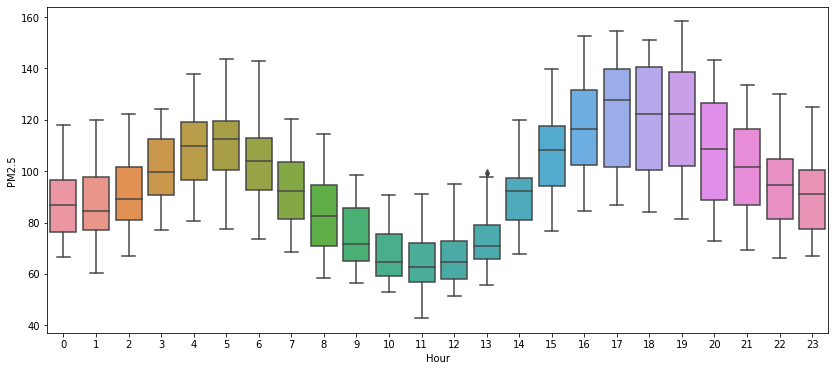

In [37]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df1['PM2.5'], data=df1)
plt.show()

In [38]:
fig = px.box(df1, x="Hour", y=df1['PM2.5'])
fig.show()

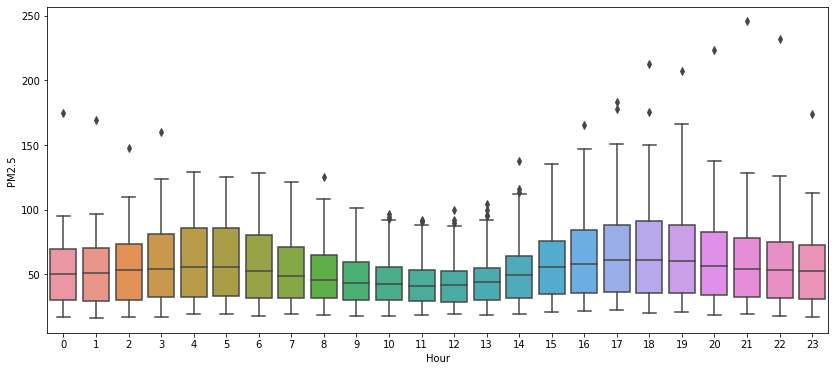

In [39]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df2['PM2.5'], data=df2)
plt.show()

In [40]:
fig = px.box(df2, x="Hour", y=df2['PM2.5'])
fig.show()

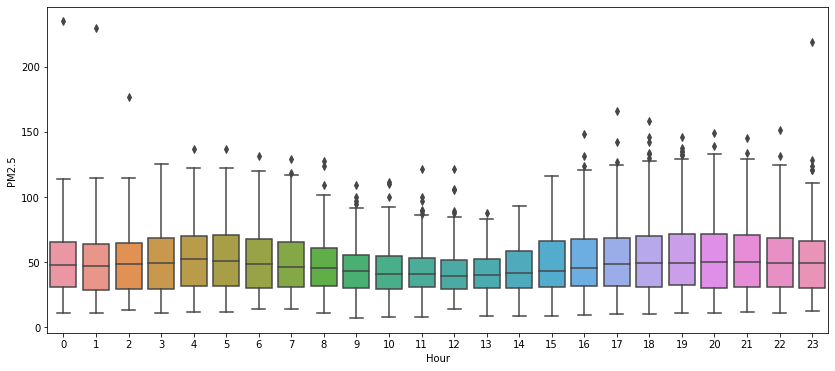

In [41]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df3['PM2.5'], data=df3)
plt.show()

In [42]:
fig = px.box(df3, x="Hour", y=df3['PM2.5'])
fig.show()

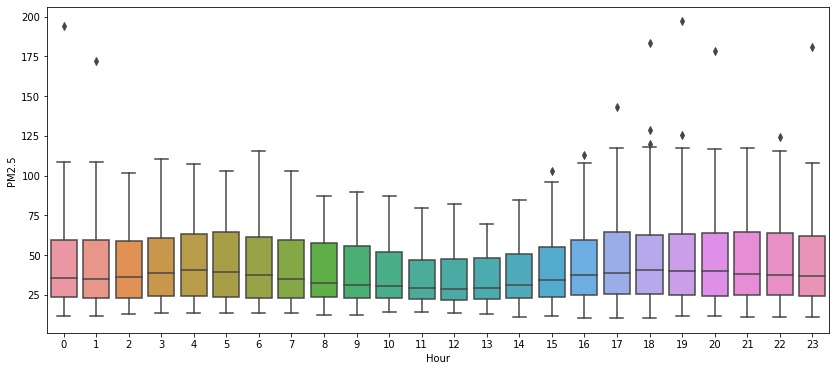

In [43]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df4['PM2.5'], data=df4)
plt.show()

In [44]:
fig = px.box(df4, x="Hour", y=df4['PM2.5'])
fig.show()

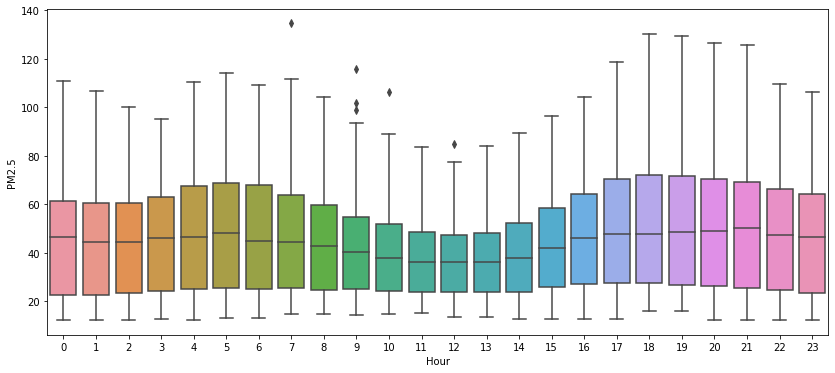

In [45]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df5['PM2.5'], data=df5)
plt.show()

In [46]:
fig = px.box(df5, x="Hour", y=df5['PM2.5'])
fig.show()

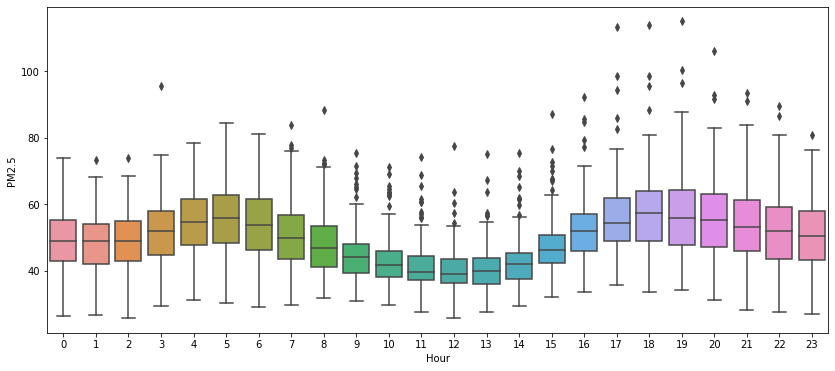

In [47]:
plt.figure(figsize = (14,6))
sns.boxplot(x = 'Hour', y = df6['PM2.5'], data=df6)
plt.show()

In [48]:
fig = px.box(df6, x="Hour", y=df6['PM2.5'])
fig.show()

In [49]:
fig = px.box(df1, x="Day", y=df1['PM2.5'])
fig.show()

In [50]:
fig = px.box(df2, x="Day", y=df2['PM2.5'])
fig.show()

In [51]:
fig = px.box(df3, x="Day", y=df3['PM2.5'])
fig.show()

In [52]:
fig = px.box(df4, x="Day", y=df4['PM2.5'])
fig.show()

In [53]:
fig = px.box(df5, x="Day", y=df5['PM2.5'])
fig.show()

In [54]:
fig = px.box(df6, x="Day", y=df6['PM2.5'])
fig.show()

In [55]:
fig = px.box(df1, x="Month", y=df1['PM2.5'])
fig.show()

In [56]:
fig = px.box(df2, x="Month", y=df2['PM2.5'])
fig.show()

In [57]:
fig = px.box(df3, x="Month", y=df3['PM2.5'])
fig.show()

In [58]:
fig = px.box(df4, x="Month", y=df4['PM2.5'])
fig.show()

In [59]:
fig = px.box(df5, x="Month", y=df5['PM2.5'])
fig.show()

In [60]:
fig = px.box(df6, x="Month", y=df6['PM2.5'])
fig.show()

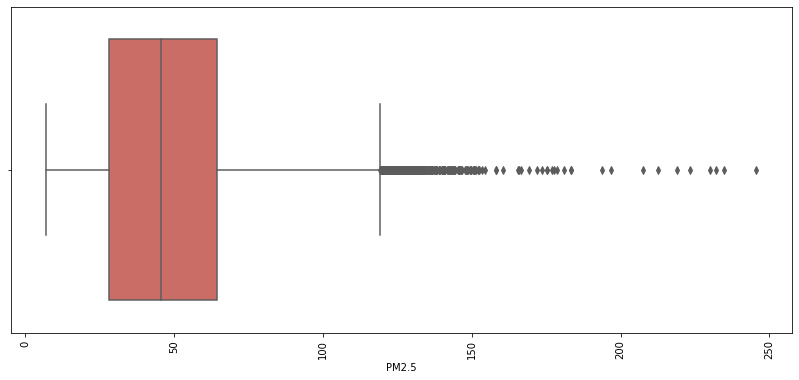

In [61]:
plt.figure(figsize = (14,6))
sns.boxplot(df_new['PM2.5'],data=df_new, palette = 'hls')
plt.xticks(rotation = 90)
plt.yticks(rotation = 90)
plt.show()

In [62]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

Year      2.00
Month     7.00
Day      15.00
Hour     12.00
PM2.5    36.44
dtype: float64


In [63]:
df_new = df_new[~((df_new < (Q1 - 1.5 * IQR))|(df_new > (Q3 + 1.5 * IQR))).any(axis=1)]

In [64]:
df_new.shape

(35814, 5)

In [65]:
fig = px.scatter_3d(df_new, x = "Year", y = "Month", z = "PM2.5",
                    color = "PM2.5", color_continuous_scale = ["#00FF00", "#FFC800", "#FF0000", "#B803BF"], 
                    range_color = (-45, 225)) # range of color bar

fig.update_traces(marker = dict(size = 3.5)) # scaling down the markers
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 12))
fig.show()

In [66]:
fig = px.scatter_3d(df_new, x = "Month", y = "Day", z = "PM2.5",
                    color = "PM2.5", color_continuous_scale = ["#00FF00", "#FFC800", "#FF0000", "#B803BF"], 
                    range_color = (-45, 225)) # range of color bar

fig.update_traces(marker = dict(size = 2.5)) # scaling down the markers
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 12))
fig.show()

In [67]:
fig = px.scatter_3d(df_new, x = "Month", y = "Day", range_z = [0, 250], z = "PM2.5",
                    color = "PM2.5", color_continuous_scale = ["#00FF00", "#FFC800", "#FF0000", "#B803BF"],
                    animation_frame = "Hour", range_color = (-45, 225)) # range of color bar

fig.update_traces(marker = dict(size = 3.5)) # scaling down the markers
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 12))
fig.show()

In [68]:
fig = px.scatter_3d(df_new, x = "Day", y = "Hour", z = "PM2.5",
                    color = "PM2.5", color_continuous_scale = ["#00FF00", "#FFC800", "#FF0000", "#B803BF"], 
                    range_color = (-45, 225)) # range of color bar

fig.update_traces(marker = dict(size = 2.5)) # scaling down the markers
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 12))
fig.show()

In [69]:
fig = px.scatter_3d(df_new, x = "Year", y = "Day", range_z = [0,250], z = "PM2.5",
                    color = "PM2.5", color_continuous_scale = ["#00FF00", "#FFC800", "#FF0000", "#B803BF"],
                    animation_frame = "Hour", range_color = (-45, 225)) # range of color bar

fig.update_traces(marker = dict(size = 3.5)) # scaling down the markers
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 12))
fig.show()

In [70]:
fig = px.box(df_new, x = "Year", y = "PM2.5", points = "all", color = "Year",
             color_discrete_sequence = px.colors.qualitative.Set3,
             title = "PM2.5 Distribution by Year")

fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 20))

fig.update_traces(marker = dict(size = 0.75)) # scaling down the markers

fig.show()

In [71]:
fig = px.histogram(df_new, x = "Year", y = "PM2.5", color="Month", hover_data = df_new.columns,
                   color_discrete_sequence = px.colors.qualitative.Set3, 
                   title = "Sum of PM2.5 Distribution by Year and Month" )

fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 15))
fig.show()

In [72]:
fig = px.box(df_new, x = "Month", y = "PM2.5", points = "all", color = "Month",
             color_discrete_sequence = px.colors.qualitative.Set3,
             title = "PM2.5 Distribution by Month")

fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 20))

fig.update_traces(marker = dict(size = 0.75)) # scaling down the markers

fig.show()

In [73]:
# Isolate 2018-2021 to view years with data from every month

fig = px.histogram(df_new, x = "Month", y = "PM2.5", color = "Year", hover_data = df_new.columns,
                   color_discrete_sequence = px.colors.qualitative.Set3, 
                   title = "Sum of PM2.5 Distribution by Month and Year" )

fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 15))
fig.show()

In [74]:
fig = px.density_contour(df_new, x = "Month", y = "PM2.5", title = "PM2.5 Density by Month")

fig.update_layout(yaxis_range = [0, 115])
fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 15))
fig.update_traces(contours_coloring = "fill", contours_showlabels = True)
fig.show()

In [75]:
# Here I store years 2018-2021 in a df because 2017 and 2022 does not have data from every month
df1 = df_new[df_new["Year"] > 2017]
df2 = df1[df1["Year"] < 2022]

# Then loop through every month in years 2018-2021
for i in range(1, 13):
    
    df0 = df2[df2["Month"] == i]

    fig = px.histogram(df0, x = "Day", y = "PM2.5", color="Year", hover_data = df_new.columns,
                       color_discrete_sequence = px.colors.qualitative.Pastel, 
                       title = f"Daily Sum of PM2.5 in Month: {i}/--/2018-2021")
    
    fig.update_layout(yaxis_range = [0, 11000])
    fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 20))

    fig.show()

In [76]:
# Looping through all years in dataset - 2017 and 2022 does not have data for every month
for i in range(2017, 2023):
    
    df0 = df_new[df_new["Year"] == i]

    fig = px.histogram(df0, x = "Hour", y = "PM2.5", color="Month", hover_data = df_new.columns,
                       color_discrete_sequence = px.colors.qualitative.Set3, 
                       title = f"Total Sum of PM2.5 in Year: {i} by Hour")
    
    fig.update_layout(yaxis_range = [0, 21000])
    fig.update_layout(template = "plotly_dark", font = dict(family = "PT Sans", size = 20))

    fig.show()

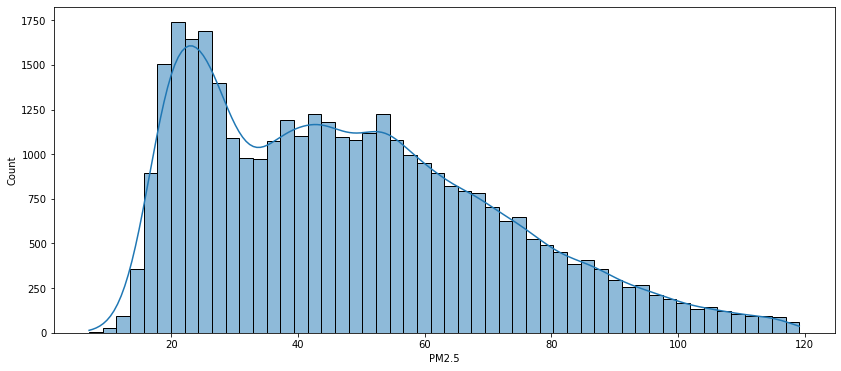

In [77]:
plt.figure(figsize = (14,6))
sns.histplot(df_new['PM2.5'], kde = True, palette = 'hls')
plt.show()

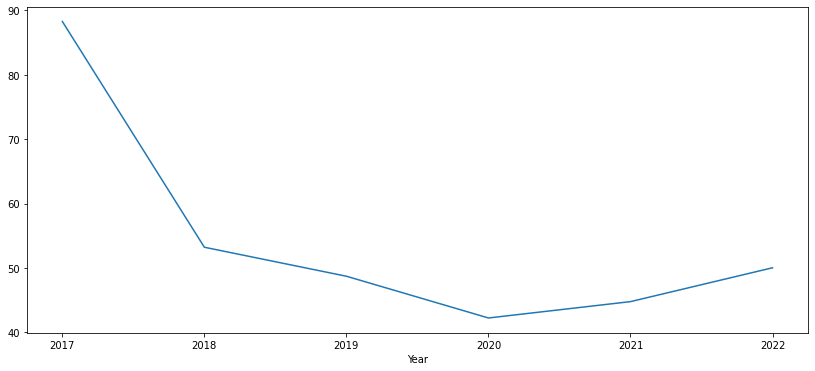

In [78]:
plt.figure(figsize = (14,6))
df_new.groupby('Year')['PM2.5'].mean().plot()
plt.show()

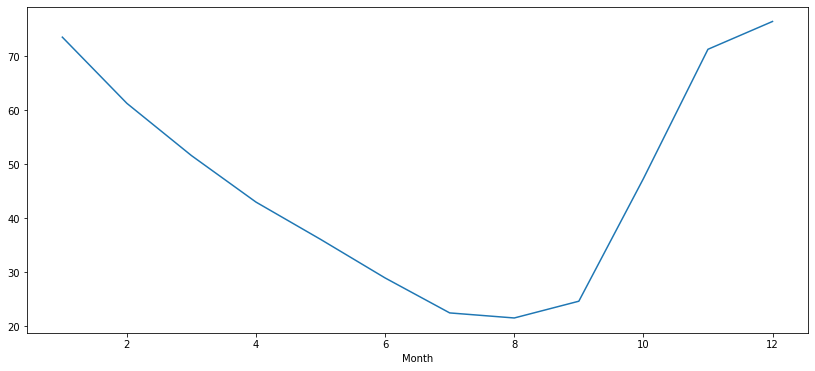

In [79]:
plt.figure(figsize = (14,6))
df_new.groupby('Month')['PM2.5'].mean().plot()
plt.show()

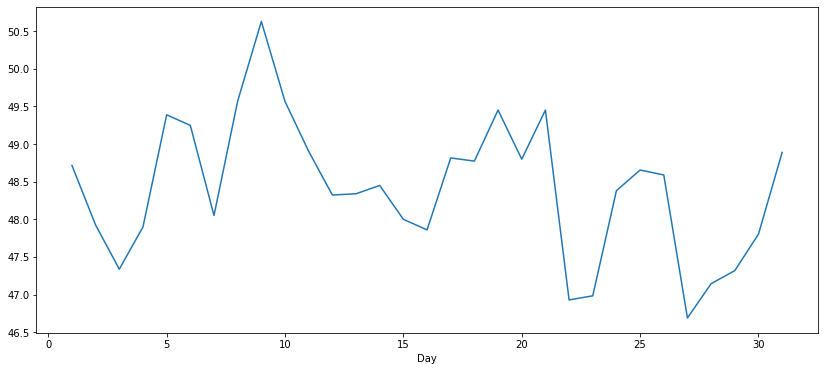

In [80]:
plt.figure(figsize = (14,6))
df_new.groupby('Day')['PM2.5'].mean().plot()
plt.show()

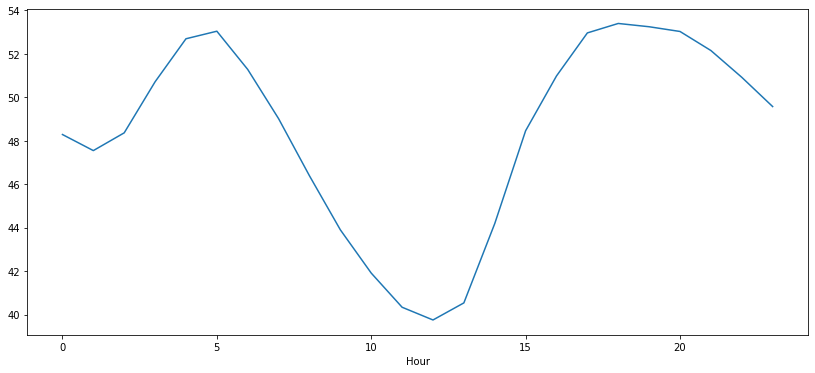

In [81]:
plt.figure(figsize = (14,6))
df_new.groupby('Hour')['PM2.5'].mean().plot()
plt.show()

In [82]:
df_new = df_new.reset_index()

In [83]:
df_new['Date']=df_new["Timestamp"].dt.date

In [84]:
df_date=pd.DataFrame(df_new.groupby('Date')['PM2.5'].mean())
df_date

,PM2.5
Date,
2017-01-12,93.488095
2017-02-12,89.929474
2017-03-12,93.410000
2017-04-12,97.727059
2017-05-12,95.460000
...,...
2022-11-05,36.367917
2022-12-01,47.640417
2022-12-02,51.887500


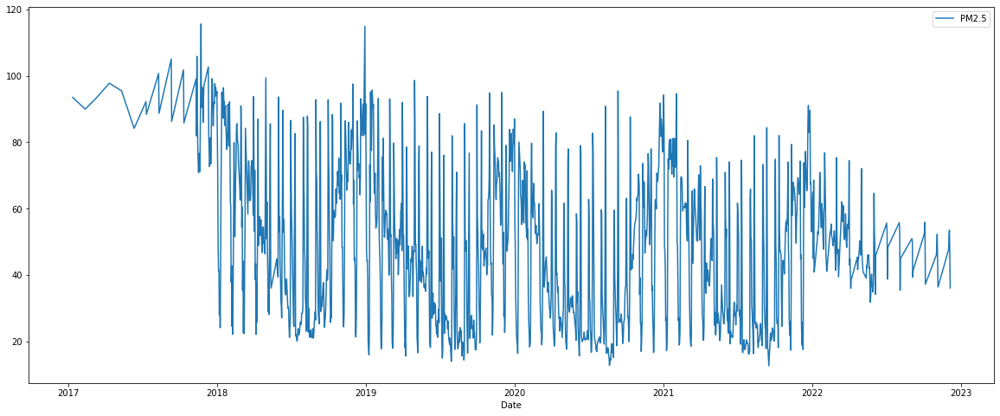

In [85]:
df_date.plot(figsize=(20,8))
plt.show()

In [86]:
import math

In [87]:
df_date.values

array([[93.48809524],
       [89.92947368],
       [93.41      ],
       ...,
       [51.8875    ],
       [53.52166667],
       [36.09541667]])

In [88]:
dataset  = df_date.values
training_data_len = math.ceil(len(dataset)*.8)
training_data_len

1293

In [89]:
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, LSTM

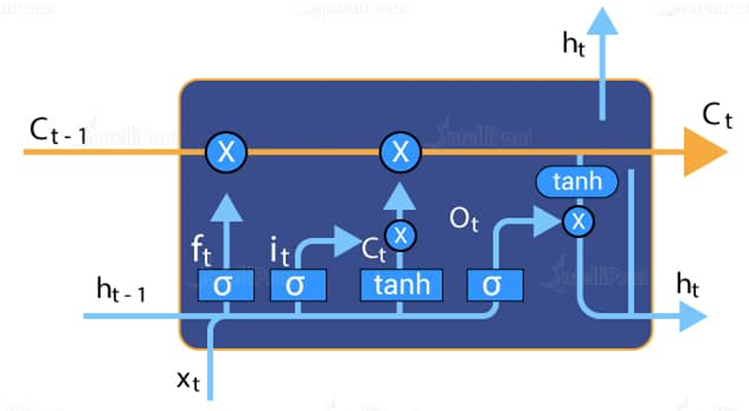

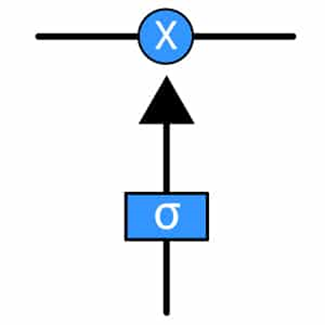

In [90]:
sc = MinMaxScaler(feature_range=(0,1))
scaled_data = sc.fit_transform(dataset)
scaled_data

array([[0.78539941],
       [0.75083098],
       [0.78464079],
       ...,
       [0.38129154],
       [0.39716583],
       [0.22788737]])

In [91]:
train_data = scaled_data[0:training_data_len, :]
x_train = []
y_train = []
num = 60
for i in range(num, len(train_data)):
    x_train.append(train_data[i-num:i , 0])
    y_train.append(train_data[i , 0])

In [92]:
x_train, y_train = np.array(x_train), np.array(y_train)
x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))
x_train.shape

(1233, 60, 1)

In [93]:
model = Sequential()
model.add(LSTM(50, return_sequences=True, input_shape=(x_train.shape[1],1)))
model.add(LSTM(50, return_sequences=False))
model.add(Dense(25))
model.add(Dense(1))

In [94]:
model.compile(optimizer = "adam", loss = "mean_squared_error")

In [95]:
model.fit(x_train,y_train, batch_size=1, epochs=1)

1233/1233 [==============================] - 39s 28ms/step - loss: 0.0303


In [96]:
test_data = scaled_data[training_data_len-60: , :]
x_test = []
y_test = dataset[training_data_len:,:]
for i in range(num, len(test_data)):
      x_test.append(test_data[i-num:i, 0])

In [97]:
x_test = np.array(x_test)
x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1))

In [98]:
predictions = model.predict(x_test)
predictions = sc.inverse_transform(predictions)

11/11 [==============================] - 2s 19ms/step


In [99]:
rmse = np.sqrt(np.mean(predictions - y_test)**2)
rmse

2.829356305878049

In [100]:
train = df_date[:training_data_len]
valid = df_date[training_data_len:]
valid["Predictions"] = predictions
valid

,PM2.5,Predictions
Date,,
2021-06-28,28.667917,31.415581
2021-06-29,30.903750,32.586498
2021-06-30,29.017917,34.058414
2021-07-01,61.623333,33.487671
2021-07-02,58.867500,49.675671
...,...,...
2022-11-05,36.367917,46.609974
2022-12-01,47.640417,38.297802
2022-12-02,51.887500,42.658024


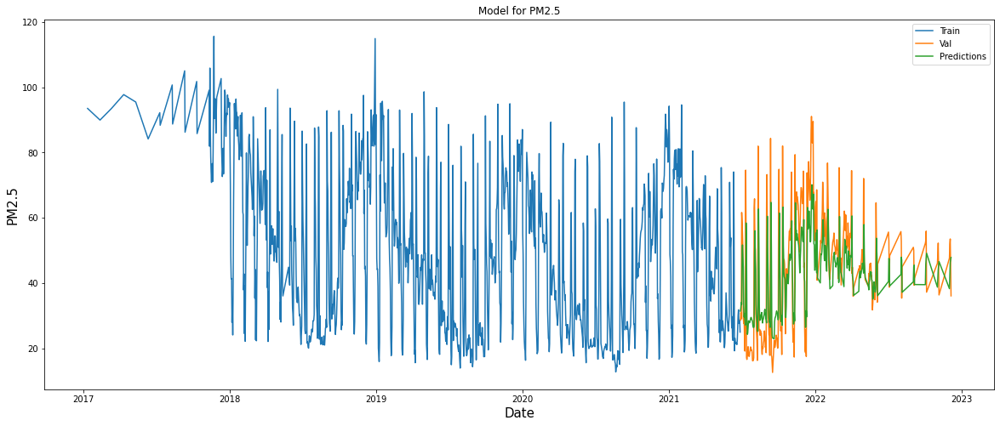

In [101]:
plt.figure(figsize=(20,8))
plt.title("Model for PM2.5")
plt.xlabel("Date", fontsize = 15)
plt.ylabel("PM2.5",fontsize=15)
plt.plot(train[df_date.columns])
plt.plot(valid['PM2.5'])
plt.plot(valid["Predictions"])
plt.legend(["Train","Val","Predictions"])
plt.show()

In [102]:
from scalecast.Forecaster import Forecaster

In [103]:
f = Forecaster(y=df_new['PM2.5'], current_dates=df_new['Date'])

In [104]:
f

Forecaster(
    DateStartActuals=2017-07-11T00:00:00.000000000
    DateEndActuals=2022-04-06T00:00:00.000000000
    Freq=None
    N_actuals=35814
    ForecastLength=0
    Xvars=[]
    Differenced=0
    TestLength=1
    ValidationLength=1
    ValidationMetric=rmse
    ForecastsEvaluated=[]
    CILevel=0.95
    BootstrapSamples=100
    CurrentEstimator=None
    GridsFile=Grids
)

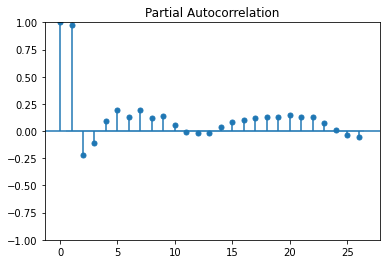

In [105]:
f.plot_pacf(lags=26)
plt.show()

In [106]:
stat, pval, _, _, _, _ = f.adf_test(full_res=True)

In [107]:
stat

-4.903180615028665

In [108]:
pval

3.438060656631586e-05

In [109]:
f.set_test_length(12)       # 1. 12 observations to test the results
f.generate_future_dates(12) # 2. 12 future points to forecast
f.set_estimator('lstm')     # 3. LSTM neural network

1119/1119 [==============================] - 3s 3ms/step


<AxesSubplot: xlabel='Date', ylabel='Values'>

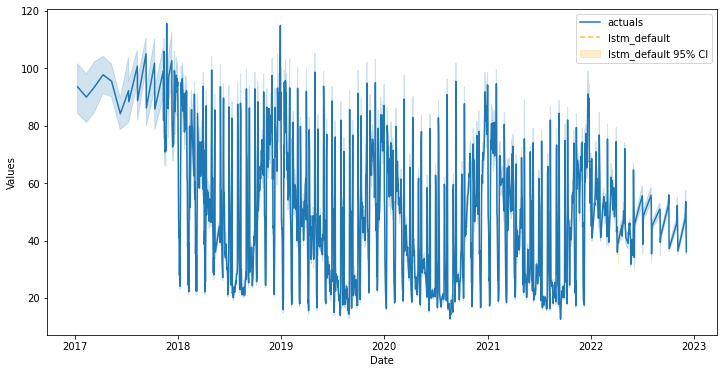

In [110]:
f.manual_forecast(call_me='lstm_default')
f.plot_test_set(ci=True)

1119/1119 [==============================] - 4s 4ms/step


<AxesSubplot: xlabel='Date', ylabel='Values'>

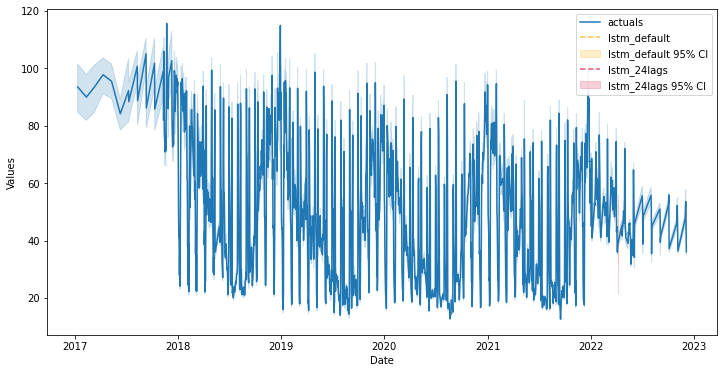

In [111]:
f.manual_forecast(call_me='lstm_24lags',lags=24)
f.plot_test_set(ci=True)

Epoch 1/5
895/895 [==============================] - 18s 17ms/step - loss: 0.0704 - val_loss: 0.0676
Epoch 2/5
895/895 [==============================] - 14s 16ms/step - loss: 0.0574 - val_loss: 0.0658
Epoch 3/5
895/895 [==============================] - 14s 16ms/step - loss: 0.0561 - val_loss: 0.0655
Epoch 4/5
895/895 [==============================] - 14s 16ms/step - loss: 0.0546 - val_loss: 0.0638
Epoch 5/5
1/1 [==============================] - 0s 470ms/step
Epoch 1/5
895/895 [==============================] - 14s 13ms/step - loss: 0.0723 - val_loss: 0.0712
Epoch 2/5
895/895 [==============================] - 11s 12ms/step - loss: 0.0581 - val_loss: 0.0670
Epoch 3/5
895/895 [==============================] - 10s 12ms/step - loss: 0.0575 - val_loss: 0.0666
Epoch 4/5
895/895 [==============================] - 10s 12ms/step - loss: 0.0570 - val_loss: 0.0674
Epoch 5/5
1119/1119 [==============================] - 5s 5ms/step


<AxesSubplot: xlabel='Date', ylabel='Values'>

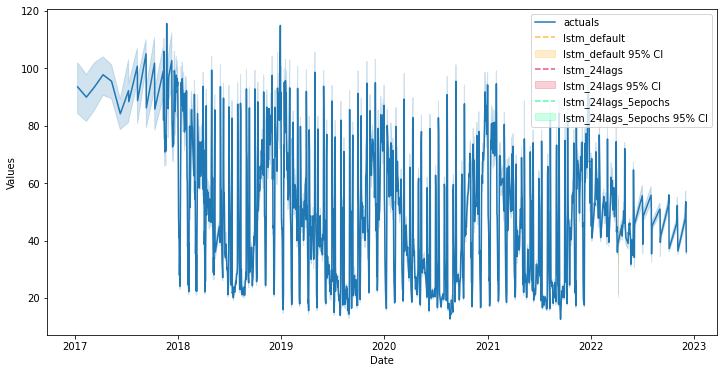

In [112]:
f.manual_forecast(call_me='lstm_24lags_5epochs',
                  lags=24,
                  epochs=5,
                  validation_split=.2,
                  shuffle=True)
f.plot_test_set(ci=True)

Epoch 1/25
895/895 [==============================] - 44s 43ms/step - loss: 0.0665 - val_loss: 0.0671
Epoch 2/25
895/895 [==============================] - 36s 40ms/step - loss: 0.0545 - val_loss: 0.0657
Epoch 3/25
895/895 [==============================] - 36s 40ms/step - loss: 0.0495 - val_loss: 0.0631
Epoch 4/25
895/895 [==============================] - 36s 40ms/step - loss: 0.0485 - val_loss: 0.0639
Epoch 5/25
895/895 [==============================] - 36s 40ms/step - loss: 0.0477 - val_loss: 0.0621
Epoch 6/25
895/895 [==============================] - 37s 41ms/step - loss: 0.0464 - val_loss: 0.0621
Epoch 7/25
895/895 [==============================] - 36s 41ms/step - loss: 0.0452 - val_loss: 0.0607
Epoch 8/25
895/895 [==============================] - 36s 40ms/step - loss: 0.0443 - val_loss: 0.0598
Epoch 9/25
895/895 [==============================] - 37s 41ms/step - loss: 0.0435 - val_loss: 0.0588
Epoch 10/25
895/895 [==============================] - 36s 40ms/step - loss: 0.042

<AxesSubplot: xlabel='Date', ylabel='Values'>

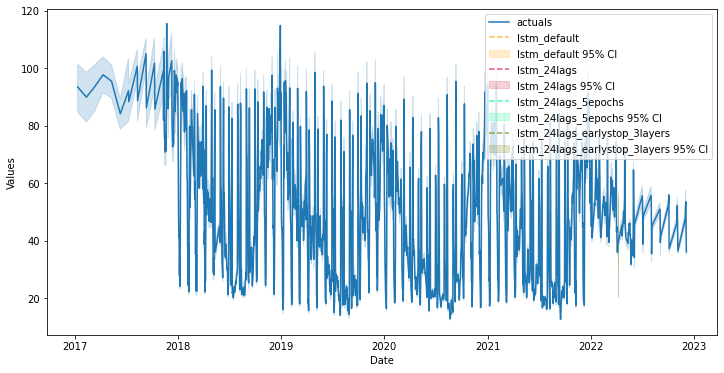

In [113]:
from tensorflow.keras.callbacks import EarlyStopping
f.manual_forecast(call_me='lstm_24lags_earlystop_3layers',
                  lags=24,
                  epochs=25,
                  validation_split=.2,
                  shuffle=True,
                  callbacks=EarlyStopping(monitor='val_loss',
                                          patience=5),
                  lstm_layer_sizes=(16,16,16),
                  dropout=(0,0,0))
f.plot_test_set(ci=True)

Epoch 1/15
894/894 [==============================] - 273s 295ms/step - loss: 0.0586 - val_loss: 0.0645
Epoch 2/15
894/894 [==============================] - 239s 267ms/step - loss: 0.0446 - val_loss: 0.0579
Epoch 3/15
894/894 [==============================] - 276s 308ms/step - loss: 0.0418 - val_loss: 0.0560
Epoch 4/15
894/894 [==============================] - 253s 283ms/step - loss: 0.0401 - val_loss: 0.0540
Epoch 5/15
894/894 [==============================] - 265s 297ms/step - loss: 0.0396 - val_loss: 0.0536
Epoch 6/15
894/894 [==============================] - 261s 292ms/step - loss: 0.0390 - val_loss: 0.0536
Epoch 7/15
894/894 [==============================] - 230s 257ms/step - loss: 0.0386 - val_loss: 0.0526
Epoch 8/15
894/894 [==============================] - 212s 237ms/step - loss: 0.0383 - val_loss: 0.0525
Epoch 9/15
894/894 [==============================] - 262s 294ms/step - loss: 0.0380 - val_loss: 0.0521
Epoch 10/15
894/894 [==============================] - 264s 296m

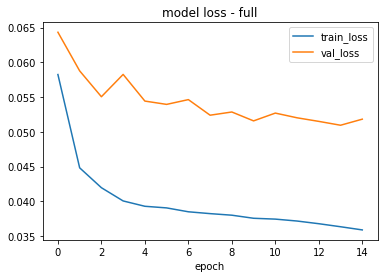

1118/1118 [==============================] - 40s 36ms/step


<AxesSubplot: xlabel='Date', ylabel='Values'>

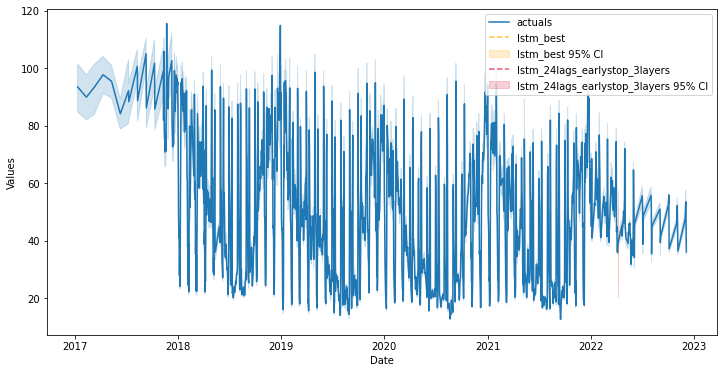

In [114]:
f.manual_forecast(call_me='lstm_best',
                  lags=36,
                  batch_size=32,
                  epochs=15,
                  validation_split=.2,
                  shuffle=True,
                  activation='tanh',
                  optimizer='Adam',
                  learning_rate=0.001,
                  lstm_layer_sizes=(72,)*4,
                  dropout=(0,)*4,
                  plot_loss=True)
f.plot_test_set(order_by='LevelTestSetMAPE',models='top_2',ci=True)

In [115]:
f.set_estimator('mlr') # 1. choose the mlr estimator
f.add_ar_terms(24) # 2. add regressors (24 lagged terms)
f.add_seasonal_regressors('month','quarter',dummy=True) # 2.
f.add_seasonal_regressors('year') # 2.
f.add_time_trend() # 2.
f.diff() # 3. difference non-stationary data

<AxesSubplot: xlabel='Date', ylabel='Values'>

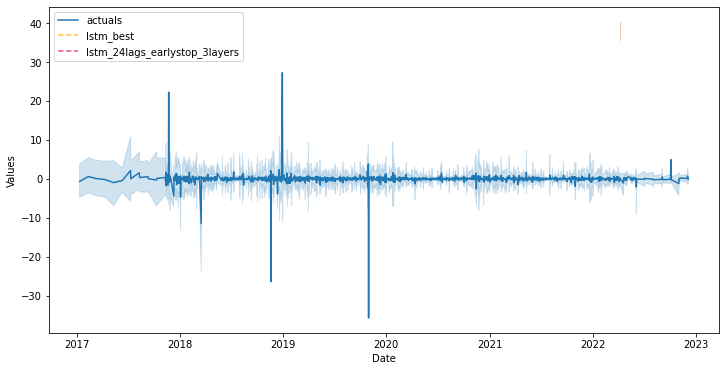

In [116]:
f.manual_forecast()
f.plot_test_set(order_by='LevelTestSetMAPE',models='top_2')

<AxesSubplot: xlabel='Date', ylabel='Values'>

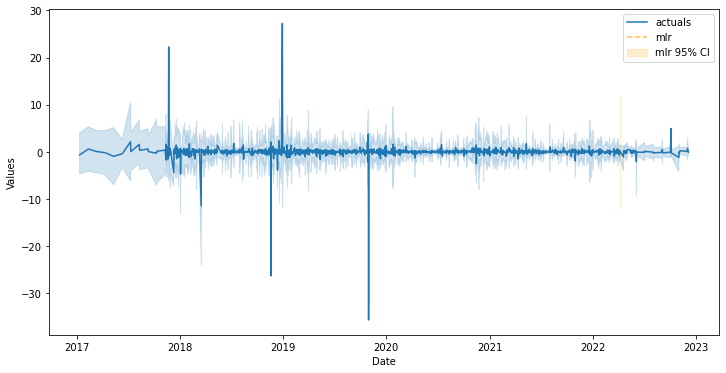

In [117]:
f.plot_test_set(models='mlr',ci=True)

<AxesSubplot: xlabel='Date', ylabel='Values'>

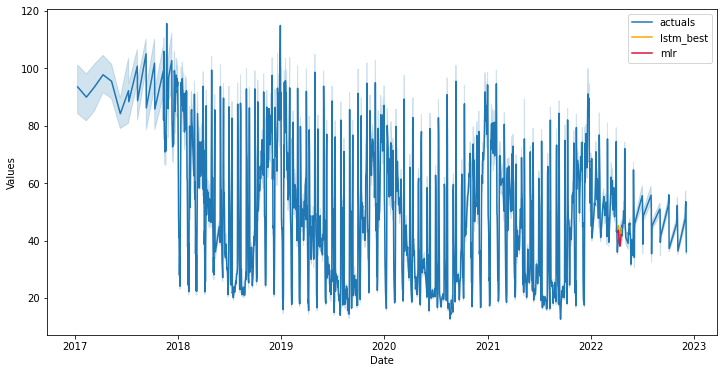

In [118]:
f.plot(models=['mlr','lstm_best'],
       order_by='LevelTestSetMAPE',
       level=True)

In [119]:
f.export('model_summaries',determine_best_by='LevelTestSetMAPE')[
    ['ModelNickname',
     'LevelTestSetMAPE',
     'LevelTestSetRMSE',
     'LevelTestSetR2',
     'best_model']
]

,ModelNickname,LevelTestSetMAPE,LevelTestSetRMSE,LevelTestSetR2,best_model
0,lstm_best,0.030789,1.522351,0.844392,True
1,lstm_24lags_earlystop_3layers,0.037266,1.745171,0.795506,False
2,mlr,0.048469,2.237482,0.663858,False
3,lstm_24lags_5epochs,0.071070,3.323231,0.258477,False
4,lstm_24lags,0.086741,3.720583,0.070551,False
5,lstm_default,0.146367,5.999161,-1.416487,False
